In [11]:
import os
import torch
import numpy as np
import cv2
import wandb
from tqdm import tqdm
import segmentation_models_pytorch as smp
from torch.utils.data import DataLoader
import albumentations as A
from albumentations.pytorch import ToTensorV2
import PIL.Image
import matplotlib.pyplot as plt
from IPython.display import display
import scipy.stats as st
from torch.utils.data import Dataset
import torch.nn.functional as F
from timesformer_pytorch import TimeSformer
import torch.nn as nn
import torch.optim
import collections
from torch.serialization import add_safe_globals

# Добавляем необходимые классы в safe_globals
add_safe_globals([
    torch.optim.lr_scheduler.CosineAnnealingLR,
    torch.optim.AdamW,
    collections.defaultdict,
    dict
])

class CFG:
    # Базовая конфигурация
    in_chans = 26
    size = 64
    tile_size = 64
    stride = 32
    start_idx = 15
    workers = 4
    batch_size = 64
    device = 'cuda'
    model_compile = True
    
    valid_aug_list = [
        A.Resize(size, size),
        A.Normalize(
            mean=[0] * in_chans,
            std=[1] * in_chans
        ),
        ToTensorV2(transpose_mask=True),
    ]

def gkern(kernlen=21, nsig=3):
    """Returns a 2D Gaussian kernel."""
    x = np.linspace(-nsig, nsig, kernlen+1)
    kern1d = np.diff(st.norm.cdf(x))
    kern2d = np.outer(kern1d, kern1d)
    return kern2d/kern2d.sum()

class CustomDatasetTest(Dataset):
    def __init__(self, images, xyxys, cfg, transform=None):
        self.images = images
        self.xyxys = xyxys
        self.cfg = cfg
        self.transform = transform

    def __len__(self):
        return len(self.images)
    
    def __getitem__(self, idx):
        image = self.images[idx]
        xy = self.xyxys[idx]
        if self.transform:
            data = self.transform(image=image)
            image = data['image'].unsqueeze(0)
        return image, xy

class RegressionPLModel(nn.Module):
    def __init__(self, pred_shape=None, size=64, with_norm=False):
        super(RegressionPLModel, self).__init__()
        self.pred_shape = pred_shape
        self.with_norm = with_norm
        
        self.backbone=TimeSformer(
                dim = 512,
                image_size = 64,
                patch_size = 16,
                num_frames = 30,
                num_classes = 16,
                channels=1,
                depth = 8,
                heads = 6,
                dim_head =  64,
                attn_dropout = 0.1,
                ff_dropout = 0.1
            )
        
        if self.with_norm:
            self.normalization = nn.BatchNorm3d(num_features=1)

    def forward(self, x):
        if x.ndim == 4:
            x = x[:, None]
        if self.with_norm:
            x = self.normalization(x)
        x = self.backbone(torch.permute(x, (0, 2, 1, 3, 4)))
        x = x.view(-1, 1, 4, 4)
        return x

def evaluate_segment(
    segment_id: str,
    model_path: str,
    data_path: str = './train_scrolls',
    device: str = 'cuda',
    batch_size: int = 64,
    workers: int = 4,
    size: int = 64,
    stride: int = 32,
    start_idx: int = 15,
    model_compile: bool = True
):
    """
    Функция для оценки качества сегментации на одном сегменте.
    
    Параметры:
    segment_id (str): ID сегмента для оценки
    model_path (str): путь к файлу модели
    data_path (str): путь к директории с данными
    """
    device = torch.device(device if torch.cuda.is_available() else 'cpu')
    
    def read_image_mask(fragment_id, start_idx=15, end_idx=41):
        images = []
        idxs = range(start_idx, end_idx)

        for i in idxs:
            fragment_path = f"{data_path}/{fragment_id}/layers/{i:02}"
            if os.path.exists(f"{fragment_path}.tif"):
                image = cv2.imread(f"{fragment_path}.tif", 0)
            else:
                image = cv2.imread(f"{fragment_path}.jpg", 0)
            pad0 = (256 - image.shape[0] % 256)
            pad1 = (256 - image.shape[1] % 256)
            image = np.pad(image, [(0, pad0), (0, pad1)], constant_values=0)
            image = np.clip(image, 0, 200)
            images.append(image)
        images = np.stack(images, axis=2)
        
        # Загрузка маски сегмента
        fragment_mask = cv2.imread(f"{data_path}/{fragment_id}/{fragment_id}_mask.png", 0)
        fragment_mask = np.pad(fragment_mask, [(0, pad0), (0, pad1)], constant_values=0)
        
        # Загрузка ground truth маски
        true_mask = cv2.imread(f"{data_path}/{fragment_id}/{fragment_id}_inklabels.png", 0)
        true_mask = cv2.resize(true_mask, (images.shape[1], images.shape[0]))
        true_mask = true_mask.astype('float32') / 255.0
        
        return images, fragment_mask, true_mask

    def get_img_splits(fragment_id, s, e):
        images = []
        xyxys = []
        
        image, fragment_mask, true_mask = read_image_mask(fragment_id, s, e)
        
        x1_list = list(range(0, image.shape[1]-CFG.tile_size+1, stride))
        y1_list = list(range(0, image.shape[0]-CFG.tile_size+1, stride))
        
        for y1 in y1_list:
            for x1 in x1_list:
                y2 = y1 + CFG.tile_size
                x2 = x1 + CFG.tile_size
                if not np.any(fragment_mask[y1:y2, x1:x2]==0):
                    images.append(image[y1:y2, x1:x2])
                    xyxys.append([x1, y1, x2, y2])
                    
        test_dataset = CustomDatasetTest(
            images,
            np.stack(xyxys), 
            CFG,
            transform=A.Compose(CFG.valid_aug_list)
        )

        test_loader = DataLoader(
            test_dataset,
            batch_size=batch_size,
            shuffle=False,
            num_workers=workers,
            pin_memory=True,
            drop_last=False,
        )
        
        return test_loader, np.stack(xyxys), (image.shape[0], image.shape[1]), fragment_mask, true_mask

    def predict_fn(test_loader, model, device, test_xyxys, pred_shape):
        mask_pred = np.zeros(pred_shape)
        mask_count = np.zeros(pred_shape)
        kernel = gkern(CFG.size, 1)
        kernel = kernel / kernel.max()
        model.eval()

        kernel_tensor = torch.tensor(kernel, device=device)

        for step, (images, xys) in tqdm(enumerate(test_loader), total=len(test_loader)):
            images = images.to(device)
            with torch.no_grad():
                y_preds = model(images)
            y_preds = torch.sigmoid(y_preds)
            y_preds_resized = F.interpolate(y_preds.float(), scale_factor=16, mode='bilinear')
            y_preds_multiplied = y_preds_resized * kernel_tensor
            y_preds_multiplied = y_preds_multiplied.squeeze(1)
            y_preds_multiplied_cpu = y_preds_multiplied.cpu().numpy()

            for i, (x1, y1, x2, y2) in enumerate(xys):
                mask_pred[y1:y2, x1:x2] += y_preds_multiplied_cpu[i]
                mask_count[y1:y2, x1:x2] += np.ones((size, size))

        mask_pred /= np.clip(mask_count, a_min=1, a_max=None)
        return mask_pred

    def calculate_metrics(pred_mask, true_mask, threshold=0.5):
        """Calculate segmentation metrics."""
        # Преобразуем маски в тензоры PyTorch
        pred = torch.from_numpy(pred_mask[None, None, ...])
        target = torch.from_numpy(true_mask[None, None, ...])
        
        # Бинаризуем предсказания
        pred = (pred > threshold).float()
        target = (target > 0.5).float()
        
        # Вычисляем TP, FP, TN, FN
        tp = torch.sum((pred == 1) & (target == 1)).float()
        fp = torch.sum((pred == 1) & (target == 0)).float()
        tn = torch.sum((pred == 0) & (target == 0)).float()
        fn = torch.sum((pred == 0) & (target == 1)).float()
        
        # Вычисляем метрики
        precision = tp / (tp + fp + 1e-7)
        recall = tp / (tp + fn + 1e-7)
        dice = 2 * tp / (2 * tp + fp + fn + 1e-7)
        iou = tp / (tp + fp + fn + 1e-7)
        
        return {
            'dice': dice.item(),
            'iou': iou.item(),
            'precision': precision.item(),
            'recall': recall.item()
        }

    # Загрузка модели
    model = RegressionPLModel()
    checkpoint = torch.load(model_path, map_location=device, weights_only=False)  # Добавляем weights_only=False
    model.load_state_dict(checkpoint['state_dict'], strict=False)
    if model_compile:
        model = torch.compile(model)
    model.to(device)
    model.eval()

    # Получение данных для инференса
    img_split = get_img_splits(
        segment_id,
        start_idx,
        start_idx + 26  # количество входных каналов
    )
    
    if img_split is None:
        print(f"Failed to process segment {segment_id}")
        return None
        
    test_loader, test_xyxys, test_shape, fragment_mask, true_mask = img_split

    # Инференс
    pred_mask = predict_fn(test_loader, model, device, test_xyxys, test_shape)
    pred_mask = np.clip(np.nan_to_num(pred_mask), a_min=0, a_max=1)
    
    # Расчет метрик
    pred_mask_bin = (pred_mask > 0.5).astype(np.uint8)
    true_mask_bin = (true_mask > 0.5).astype(np.uint8)
    
    metrics = calculate_metrics(pred_mask, true_mask)
    
    # Вывод результатов
    print("\nSegmentation Metrics:")
    print(f"Segment ID: {segment_id}")
    print(f"Model: {os.path.basename(model_path)}")
    print("-" * 40)
    print(f"Dice Score: {metrics['dice']:.4f}")
    print(f"IoU Score: {metrics['iou']:.4f}")
    print(f"Precision: {metrics['precision']:.4f}")
    print(f"Recall: {metrics['recall']:.4f}")
    
    # Визуализация
    fig = plt.figure(figsize=(15, 5), dpi=150)
    
    plt.subplot(131)
    plt.imshow(true_mask, cmap='gray')
    plt.title('Ground Truth')
    plt.axis('off')
    
    plt.subplot(132)
    plt.imshow(pred_mask, cmap='gray')
    plt.title('Prediction')
    plt.axis('off')
    
    plt.subplot(133)
    plt.imshow(np.abs(true_mask - pred_mask), cmap='jet')
    plt.title('Difference')
    plt.colorbar()
    plt.axis('off')
    
    plt.suptitle(f"Segment: {segment_id}\nDice: {metrics['dice']:.4f}, IoU: {metrics['iou']:.4f}")
    plt.tight_layout()
    plt.show()
    #plt.close()
    
    return metrics, pred_mask, true_mask

# BASELINE OLD LABELS

100%|██████████| 3183/3183 [06:48<00:00,  7.80it/s]



Segmentation Metrics:
Segment ID: 20241030152031
Model: old_baseline_wild16_20231210121321_frepoch=17.ckpt
----------------------------------------
Dice Score: 0.3138
IoU Score: 0.1861
Precision: 0.2629
Recall: 0.3890


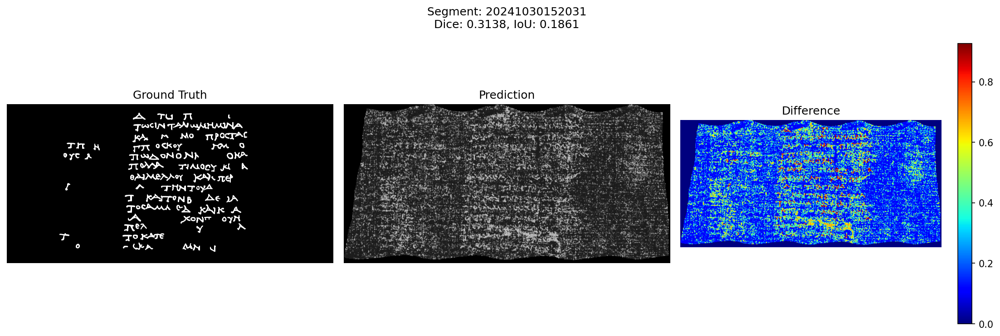

In [3]:
metrics, pred_mask, true_mask = evaluate_segment(
    segment_id="20241030152031", # vaild scroll5
    model_path="/home/jovyan/Bulygin/villa-main/ink-detection/outputs/vesuvius/old_baseline_wild16_20231210121321_frepoch=17.ckpt",
    data_path="./train_scrolls/"
)

100%|██████████| 2578/2578 [06:29<00:00,  6.62it/s]



Segmentation Metrics:
Segment ID: 20231210121321
Model: old_baseline_wild16_20231210121321_frepoch=17.ckpt
----------------------------------------
Dice Score: 0.4936
IoU Score: 0.3277
Precision: 0.7596
Recall: 0.3656


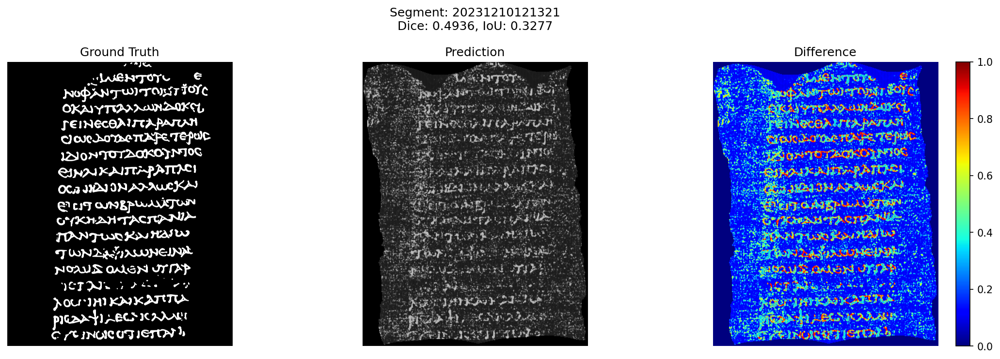

In [2]:
metrics, pred_mask, true_mask = evaluate_segment(
    segment_id="20231210121321", # vaild scroll1
    model_path="/home/jovyan/Bulygin/villa-main/ink-detection/outputs/vesuvius/old_baseline_wild16_20231210121321_frepoch=17.ckpt",
    data_path="./train_scrolls/")

# BASELINE NEW LABELS

100%|██████████| 3183/3183 [06:50<00:00,  7.75it/s]



Segmentation Metrics:
Segment ID: 20241030152031
Model: timesformer_wild16_20231210121321_frepoch=17.ckpt
----------------------------------------
Dice Score: 0.2918
IoU Score: 0.1708
Precision: 0.2771
Recall: 0.3081


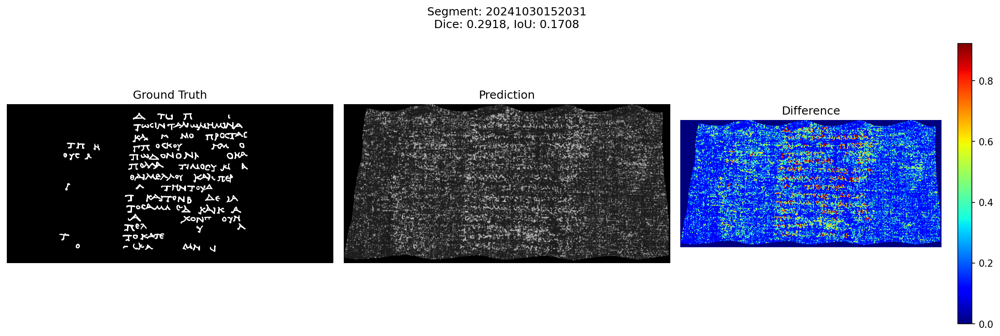

In [4]:
metrics, pred_mask, true_mask = evaluate_segment(
    segment_id="20241030152031", # vaild scroll5
    model_path="/home/jovyan/Bulygin/villa-main/ink-detection/outputs/vesuvius/pretraining_original-baseline_newlabels_batchsize196/vesuvius-models/timesformer_wild16_20231210121321_frepoch=17.ckpt",
    data_path="./train_scrolls/"
)

100%|██████████| 2578/2578 [06:14<00:00,  6.89it/s]



Segmentation Metrics:
Segment ID: 20231210121321
Model: timesformer_wild16_20231210121321_frepoch=17.ckpt
----------------------------------------
Dice Score: 0.4972
IoU Score: 0.3309
Precision: 0.7855
Recall: 0.3637


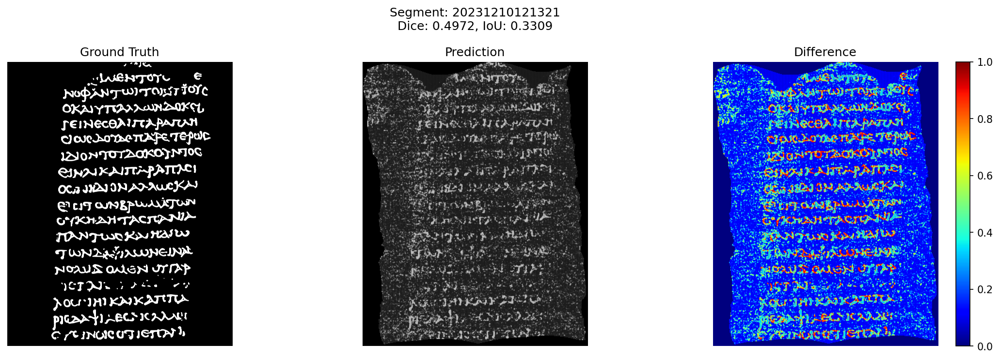

In [ ]:
metrics, pred_mask, true_mask = evaluate_segment(
    segment_id="20231210121321", # vaild scroll1
    model_path="/home/jovyan/Bulygin/villa-main/ink-detection/outputs/vesuvius/pretraining_original-baseline_newlabels_batchsize196/vesuvius-models/timesformer_wild16_20231210121321_frepoch=17.ckpt",
    data_path="./train_scrolls/"
)

# HEAD=8 DEPTH=10

In [3]:
import os
import torch
import numpy as np
import cv2
import wandb
from tqdm import tqdm
import segmentation_models_pytorch as smp
from torch.utils.data import DataLoader
import albumentations as A
from albumentations.pytorch import ToTensorV2
import PIL.Image
import matplotlib.pyplot as plt
from IPython.display import display
import scipy.stats as st
from torch.utils.data import Dataset
import torch.nn.functional as F
from timesformer_pytorch import TimeSformer
import torch.nn as nn
import torch.optim
import collections
from torch.serialization import add_safe_globals

# Добавляем необходимые классы в safe_globals
add_safe_globals([
    torch.optim.lr_scheduler.CosineAnnealingLR,
    torch.optim.AdamW,
    collections.defaultdict,
    dict
])

class CFG:
    # Базовая конфигурация
    in_chans = 26
    size = 64
    tile_size = 64
    stride = 32
    start_idx = 15
    workers = 4
    batch_size = 64
    device = 'cuda'
    model_compile = True
    
    valid_aug_list = [
        A.Resize(size, size),
        A.Normalize(
            mean=[0] * in_chans,
            std=[1] * in_chans
        ),
        ToTensorV2(transpose_mask=True),
    ]

def gkern(kernlen=21, nsig=3):
    """Returns a 2D Gaussian kernel."""
    x = np.linspace(-nsig, nsig, kernlen+1)
    kern1d = np.diff(st.norm.cdf(x))
    kern2d = np.outer(kern1d, kern1d)
    return kern2d/kern2d.sum()

class CustomDatasetTest(Dataset):
    def __init__(self, images, xyxys, cfg, transform=None):
        self.images = images
        self.xyxys = xyxys
        self.cfg = cfg
        self.transform = transform

    def __len__(self):
        return len(self.images)
    
    def __getitem__(self, idx):
        image = self.images[idx]
        xy = self.xyxys[idx]
        if self.transform:
            data = self.transform(image=image)
            image = data['image'].unsqueeze(0)
        return image, xy

class RegressionPLModel(nn.Module):
    def __init__(self, pred_shape=None, size=64, with_norm=False):
        super(RegressionPLModel, self).__init__()
        self.pred_shape = pred_shape
        self.with_norm = with_norm
        
        self.backbone=TimeSformer(
                dim = 512,
                image_size = 64,
                patch_size = 16,
                num_frames = 30,
                num_classes = 16,
                channels=1,
                depth = 10,
                heads = 8,
                dim_head =  64,
                attn_dropout = 0.1,
                ff_dropout = 0.1
            )
        
        if self.with_norm:
            self.normalization = nn.BatchNorm3d(num_features=1)

    def forward(self, x):
        if x.ndim == 4:
            x = x[:, None]
        if self.with_norm:
            x = self.normalization(x)
        x = self.backbone(torch.permute(x, (0, 2, 1, 3, 4)))
        x = x.view(-1, 1, 4, 4)
        return x

def evaluate_segment(
    segment_id: str,
    model_path: str,
    data_path: str = './train_scrolls',
    device: str = 'cuda',
    batch_size: int = 64,
    workers: int = 4,
    size: int = 64,
    stride: int = 32,
    start_idx: int = 15,
    model_compile: bool = True
):
    """
    Функция для оценки качества сегментации на одном сегменте.
    
    Параметры:
    segment_id (str): ID сегмента для оценки
    model_path (str): путь к файлу модели
    data_path (str): путь к директории с данными
    """
    device = torch.device(device if torch.cuda.is_available() else 'cpu')
    
    def read_image_mask(fragment_id, start_idx=15, end_idx=41):
        images = []
        idxs = range(start_idx, end_idx)

        for i in idxs:
            fragment_path = f"{data_path}/{fragment_id}/layers/{i:02}"
            if os.path.exists(f"{fragment_path}.tif"):
                image = cv2.imread(f"{fragment_path}.tif", 0)
            else:
                image = cv2.imread(f"{fragment_path}.jpg", 0)
            pad0 = (256 - image.shape[0] % 256)
            pad1 = (256 - image.shape[1] % 256)
            image = np.pad(image, [(0, pad0), (0, pad1)], constant_values=0)
            image = np.clip(image, 0, 200)
            images.append(image)
        images = np.stack(images, axis=2)
        
        # Загрузка маски сегмента
        fragment_mask = cv2.imread(f"{data_path}/{fragment_id}/{fragment_id}_mask.png", 0)
        fragment_mask = np.pad(fragment_mask, [(0, pad0), (0, pad1)], constant_values=0)
        
        # Загрузка ground truth маски
        true_mask = cv2.imread(f"{data_path}/{fragment_id}/{fragment_id}_inklabels.png", 0)
        true_mask = cv2.resize(true_mask, (images.shape[1], images.shape[0]))
        true_mask = true_mask.astype('float32') / 255.0
        
        return images, fragment_mask, true_mask

    def get_img_splits(fragment_id, s, e):
        images = []
        xyxys = []
        
        image, fragment_mask, true_mask = read_image_mask(fragment_id, s, e)
        
        x1_list = list(range(0, image.shape[1]-CFG.tile_size+1, stride))
        y1_list = list(range(0, image.shape[0]-CFG.tile_size+1, stride))
        
        for y1 in y1_list:
            for x1 in x1_list:
                y2 = y1 + CFG.tile_size
                x2 = x1 + CFG.tile_size
                if not np.any(fragment_mask[y1:y2, x1:x2]==0):
                    images.append(image[y1:y2, x1:x2])
                    xyxys.append([x1, y1, x2, y2])
                    
        test_dataset = CustomDatasetTest(
            images,
            np.stack(xyxys), 
            CFG,
            transform=A.Compose(CFG.valid_aug_list)
        )

        test_loader = DataLoader(
            test_dataset,
            batch_size=batch_size,
            shuffle=False,
            num_workers=workers,
            pin_memory=True,
            drop_last=False,
        )
        
        return test_loader, np.stack(xyxys), (image.shape[0], image.shape[1]), fragment_mask, true_mask

    def predict_fn(test_loader, model, device, test_xyxys, pred_shape):
        mask_pred = np.zeros(pred_shape)
        mask_count = np.zeros(pred_shape)
        kernel = gkern(CFG.size, 1)
        kernel = kernel / kernel.max()
        model.eval()

        kernel_tensor = torch.tensor(kernel, device=device)

        for step, (images, xys) in tqdm(enumerate(test_loader), total=len(test_loader)):
            images = images.to(device)
            with torch.no_grad():
                y_preds = model(images)
            y_preds = torch.sigmoid(y_preds)
            y_preds_resized = F.interpolate(y_preds.float(), scale_factor=16, mode='bilinear')
            y_preds_multiplied = y_preds_resized * kernel_tensor
            y_preds_multiplied = y_preds_multiplied.squeeze(1)
            y_preds_multiplied_cpu = y_preds_multiplied.cpu().numpy()

            for i, (x1, y1, x2, y2) in enumerate(xys):
                mask_pred[y1:y2, x1:x2] += y_preds_multiplied_cpu[i]
                mask_count[y1:y2, x1:x2] += np.ones((size, size))

        mask_pred /= np.clip(mask_count, a_min=1, a_max=None)
        return mask_pred

    def calculate_metrics(pred_mask, true_mask, threshold=0.5):
        """Calculate segmentation metrics."""
        # Преобразуем маски в тензоры PyTorch
        pred = torch.from_numpy(pred_mask[None, None, ...])
        target = torch.from_numpy(true_mask[None, None, ...])
        
        # Бинаризуем предсказания
        pred = (pred > threshold).float()
        target = (target > 0.5).float()
        
        # Вычисляем TP, FP, TN, FN
        tp = torch.sum((pred == 1) & (target == 1)).float()
        fp = torch.sum((pred == 1) & (target == 0)).float()
        tn = torch.sum((pred == 0) & (target == 0)).float()
        fn = torch.sum((pred == 0) & (target == 1)).float()
        
        # Вычисляем метрики
        precision = tp / (tp + fp + 1e-7)
        recall = tp / (tp + fn + 1e-7)
        dice = 2 * tp / (2 * tp + fp + fn + 1e-7)
        iou = tp / (tp + fp + fn + 1e-7)
        
        return {
            'dice': dice.item(),
            'iou': iou.item(),
            'precision': precision.item(),
            'recall': recall.item()
        }

    # Загрузка модели
    model = RegressionPLModel()
    checkpoint = torch.load(model_path, map_location=device, weights_only=False)  # Добавляем weights_only=False
    model.load_state_dict(checkpoint['state_dict'], strict=False)
    if model_compile:
        model = torch.compile(model)
    model.to(device)
    model.eval()

    # Получение данных для инференса
    img_split = get_img_splits(
        segment_id,
        start_idx,
        start_idx + 26  # количество входных каналов
    )
    
    if img_split is None:
        print(f"Failed to process segment {segment_id}")
        return None
        
    test_loader, test_xyxys, test_shape, fragment_mask, true_mask = img_split

    # Инференс
    pred_mask = predict_fn(test_loader, model, device, test_xyxys, test_shape)
    pred_mask = np.clip(np.nan_to_num(pred_mask), a_min=0, a_max=1)
    
    # Расчет метрик
    pred_mask_bin = (pred_mask > 0.5).astype(np.uint8)
    true_mask_bin = (true_mask > 0.5).astype(np.uint8)
    
    metrics = calculate_metrics(pred_mask, true_mask)
    
    # Вывод результатов
    print("\nSegmentation Metrics:")
    print(f"Segment ID: {segment_id}")
    print(f"Model: {os.path.basename(model_path)}")
    print("-" * 40)
    print(f"Dice Score: {metrics['dice']:.4f}")
    print(f"IoU Score: {metrics['iou']:.4f}")
    print(f"Precision: {metrics['precision']:.4f}")
    print(f"Recall: {metrics['recall']:.4f}")
    
    # Визуализация
    fig = plt.figure(figsize=(15, 5), dpi=150)
    
    plt.subplot(131)
    plt.imshow(true_mask, cmap='gray')
    plt.title('Ground Truth')
    plt.axis('off')
    
    plt.subplot(132)
    plt.imshow(pred_mask, cmap='gray')
    plt.title('Prediction')
    plt.axis('off')
    
    plt.subplot(133)
    plt.imshow(np.abs(true_mask - pred_mask), cmap='jet')
    plt.title('Difference')
    plt.colorbar()
    plt.axis('off')
    
    plt.suptitle(f"Segment: {segment_id}\nDice: {metrics['dice']:.4f}, IoU: {metrics['iou']:.4f}")
    plt.tight_layout()
    plt.show()
    #plt.close()
    
    return metrics, pred_mask, true_mask

  0%|          | 0/3183 [00:00<?, ?it/s]/home/jovyan/Bulygin/venv_scrolls/lib/python3.13/site-packages/torch/_inductor/compile_fx.py:194: UserWarning: TensorFloat32 tensor cores for float32 matrix multiplication available but not enabled. Consider setting `torch.set_float32_matmul_precision('high')` for better performance.
  warnings.warn(
100%|██████████| 3183/3183 [10:51<00:00,  4.88it/s]



Segmentation Metrics:
Segment ID: 20241030152031
Model: head-8_wild16_20231210121321_frepoch=9.ckpt
----------------------------------------
Dice Score: 0.5339
IoU Score: 0.3641
Precision: 0.4412
Recall: 0.6758


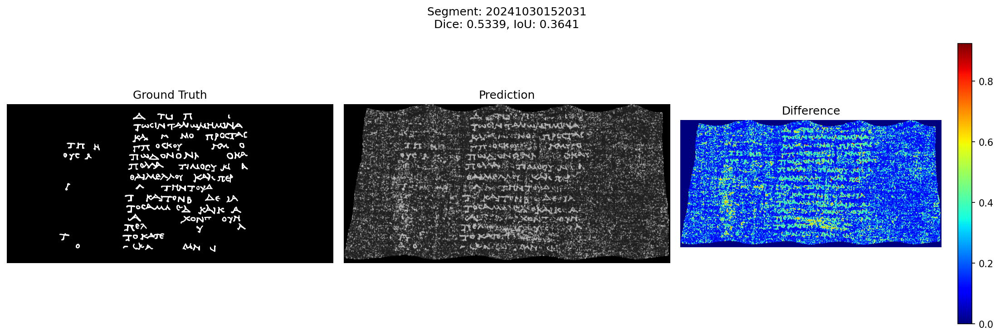

In [26]:
metrics, pred_mask, true_mask = evaluate_segment(
    segment_id="20241030152031", # vaild scroll5
    model_path="/home/jovyan/Bulygin/villa-main/ink-detection/outputs/vesuvius/head-8_wild16_20231210121321_frepoch=9.ckpt",
    data_path="./train_scrolls/"
)

100%|██████████| 2578/2578 [07:33<00:00,  5.68it/s]



Segmentation Metrics:
Segment ID: 20231210121321
Model: head-8_wild16_20231210121321_frepoch=9.ckpt
----------------------------------------
Dice Score: 0.5129
IoU Score: 0.3449
Precision: 0.7350
Recall: 0.3939


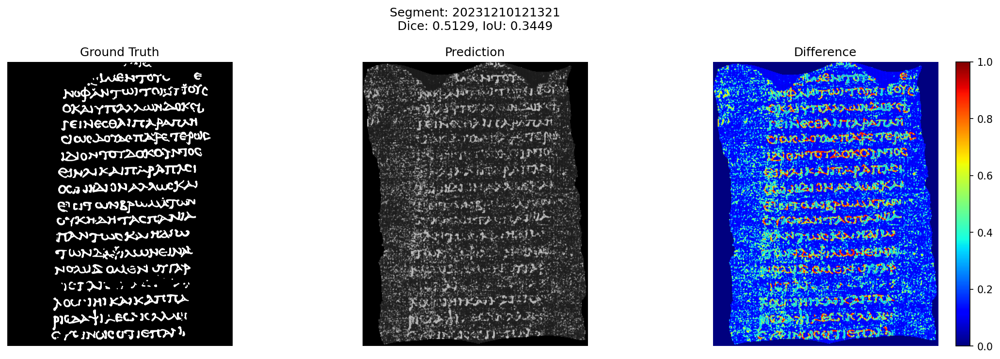

In [28]:
metrics, pred_mask, true_mask = evaluate_segment(
    segment_id="20231210121321", # vaild scroll5
    model_path="/home/jovyan/Bulygin/villa-main/ink-detection/outputs/vesuvius/head-8_wild16_20231210121321_frepoch=9.ckpt",
    data_path="./train_scrolls/"
)

# TILESIZE=16 

In [6]:
import os
import torch
import numpy as np
import cv2
import wandb
from tqdm import tqdm
import segmentation_models_pytorch as smp
from torch.utils.data import DataLoader
import albumentations as A
from albumentations.pytorch import ToTensorV2
import PIL.Image
import matplotlib.pyplot as plt
from IPython.display import display
import scipy.stats as st
from torch.utils.data import Dataset
import torch.nn.functional as F
from timesformer_pytorch import TimeSformer
import torch.nn as nn
import torch.optim
import collections
from torch.serialization import add_safe_globals

# Добавляем необходимые классы в safe_globals
add_safe_globals([
    torch.optim.lr_scheduler.CosineAnnealingLR,
    torch.optim.AdamW,
    collections.defaultdict,
    dict
])

class CFG:
    # Базовая конфигурация
    in_chans = 26
    size = 64
    tile_size = 64
    stride = 32
    start_idx = 15
    workers = 4
    batch_size = 64
    device = 'cuda'
    model_compile = True
    
    valid_aug_list = [
        A.Resize(size, size),
        A.Normalize(
            mean=[0] * in_chans,
            std=[1] * in_chans
        ),
        ToTensorV2(transpose_mask=True),
    ]

def gkern(kernlen=21, nsig=3):
    """Returns a 2D Gaussian kernel."""
    x = np.linspace(-nsig, nsig, kernlen+1)
    kern1d = np.diff(st.norm.cdf(x))
    kern2d = np.outer(kern1d, kern1d)
    return kern2d/kern2d.sum()

class CustomDatasetTest(Dataset):
    def __init__(self, images, xyxys, cfg, transform=None):
        self.images = images
        self.xyxys = xyxys
        self.cfg = cfg
        self.transform = transform

    def __len__(self):
        return len(self.images)
    
    def __getitem__(self, idx):
        image = self.images[idx]
        xy = self.xyxys[idx]
        if self.transform:
            data = self.transform(image=image)
            image = data['image'].unsqueeze(0)
        return image, xy

class RegressionPLModel(nn.Module):
    def __init__(self, pred_shape=None, size=64, with_norm=False):
        super(RegressionPLModel, self).__init__()
        self.pred_shape = pred_shape
        self.with_norm = with_norm
        
        self.backbone = TimeSformer(
            dim = 512,
            image_size = 16,  # Changed from 64 to 16
            patch_size = 8,   # Changed from 16 to 8
            num_frames = 26,
            num_classes = 16,
            channels = 1,
            depth = 8,
            heads = 6,
            dim_head = 64,
            attn_dropout = 0.1,
            ff_dropout = 0.1
        )
        
        if self.with_norm:
            self.normalization = nn.BatchNorm3d(num_features=1)

    def forward(self, x):
        if x.ndim == 4:
            x = x[:, None]
        if self.with_norm:
            x = self.normalization(x)
        x = self.backbone(torch.permute(x, (0, 2, 1, 3, 4)))
        x = x.view(-1, 1, 4, 4)
        return x

def evaluate_segment(
    segment_id: str,
    model_path: str,
    data_path: str = './train_scrolls',
    device: str = 'cuda',
    batch_size: int = 64,
    workers: int = 4,
    size: int = 64,
    stride: int = 32,
    start_idx: int = 15,
    model_compile: bool = True
):
    """
    Функция для оценки качества сегментации на одном сегменте.
    
    Параметры:
    segment_id (str): ID сегмента для оценки
    model_path (str): путь к файлу модели
    data_path (str): путь к директории с данными
    """
    device = torch.device(device if torch.cuda.is_available() else 'cpu')
    
    def read_image_mask(fragment_id, start_idx=15, end_idx=41):
        images = []
        idxs = range(start_idx, end_idx)

        for i in idxs:
            fragment_path = f"{data_path}/{fragment_id}/layers/{i:02}"
            if os.path.exists(f"{fragment_path}.tif"):
                image = cv2.imread(f"{fragment_path}.tif", 0)
            else:
                image = cv2.imread(f"{fragment_path}.jpg", 0)
            pad0 = (256 - image.shape[0] % 256)
            pad1 = (256 - image.shape[1] % 256)
            image = np.pad(image, [(0, pad0), (0, pad1)], constant_values=0)
            image = np.clip(image, 0, 200)
            images.append(image)
        images = np.stack(images, axis=2)
        
        # Загрузка маски сегмента
        fragment_mask = cv2.imread(f"{data_path}/{fragment_id}/{fragment_id}_mask.png", 0)
        fragment_mask = np.pad(fragment_mask, [(0, pad0), (0, pad1)], constant_values=0)
        
        # Загрузка ground truth маски
        true_mask = cv2.imread(f"{data_path}/{fragment_id}/{fragment_id}_inklabels.png", 0)
        true_mask = cv2.resize(true_mask, (images.shape[1], images.shape[0]))
        true_mask = true_mask.astype('float32') / 255.0
        
        return images, fragment_mask, true_mask

    def get_img_splits(fragment_id, s, e):
        images = []
        xyxys = []
        
        image, fragment_mask, true_mask = read_image_mask(fragment_id, s, e)
        
        x1_list = list(range(0, image.shape[1]-CFG.tile_size+1, stride))
        y1_list = list(range(0, image.shape[0]-CFG.tile_size+1, stride))
        
        for y1 in y1_list:
            for x1 in x1_list:
                y2 = y1 + CFG.tile_size
                x2 = x1 + CFG.tile_size
                if not np.any(fragment_mask[y1:y2, x1:x2]==0):
                    images.append(image[y1:y2, x1:x2])
                    xyxys.append([x1, y1, x2, y2])
                    
        test_dataset = CustomDatasetTest(
            images,
            np.stack(xyxys), 
            CFG,
            transform=A.Compose(CFG.valid_aug_list)
        )

        test_loader = DataLoader(
            test_dataset,
            batch_size=batch_size,
            shuffle=False,
            num_workers=workers,
            pin_memory=True,
            drop_last=False,
        )
        
        return test_loader, np.stack(xyxys), (image.shape[0], image.shape[1]), fragment_mask, true_mask

    def predict_fn(test_loader, model, device, test_xyxys, pred_shape):
        mask_pred = np.zeros(pred_shape)
        mask_count = np.zeros(pred_shape)
        kernel = gkern(CFG.size, 1)
        kernel = kernel / kernel.max()
        model.eval()

        kernel_tensor = torch.tensor(kernel, device=device)

        for step, (images, xys) in tqdm(enumerate(test_loader), total=len(test_loader)):
            images = images.to(device)
            with torch.no_grad():
                y_preds = model(images)
            y_preds = torch.sigmoid(y_preds)
            y_preds_resized = F.interpolate(y_preds.float(), scale_factor=16, mode='bilinear')
            y_preds_multiplied = y_preds_resized * kernel_tensor
            y_preds_multiplied = y_preds_multiplied.squeeze(1)
            y_preds_multiplied_cpu = y_preds_multiplied.cpu().numpy()

            for i, (x1, y1, x2, y2) in enumerate(xys):
                mask_pred[y1:y2, x1:x2] += y_preds_multiplied_cpu[i]
                mask_count[y1:y2, x1:x2] += np.ones((size, size))

        mask_pred /= np.clip(mask_count, a_min=1, a_max=None)
        return mask_pred

    def calculate_metrics(pred_mask, true_mask, threshold=0.5):
        """Calculate segmentation metrics."""
        # Преобразуем маски в тензоры PyTorch
        pred = torch.from_numpy(pred_mask[None, None, ...])
        target = torch.from_numpy(true_mask[None, None, ...])
        
        # Бинаризуем предсказания
        pred = (pred > threshold).float()
        target = (target > 0.5).float()
        
        # Вычисляем TP, FP, TN, FN
        tp = torch.sum((pred == 1) & (target == 1)).float()
        fp = torch.sum((pred == 1) & (target == 0)).float()
        tn = torch.sum((pred == 0) & (target == 0)).float()
        fn = torch.sum((pred == 0) & (target == 1)).float()
        
        # Вычисляем метрики
        precision = tp / (tp + fp + 1e-7)
        recall = tp / (tp + fn + 1e-7)
        dice = 2 * tp / (2 * tp + fp + fn + 1e-7)
        iou = tp / (tp + fp + fn + 1e-7)
        
        return {
            'dice': dice.item(),
            'iou': iou.item(),
            'precision': precision.item(),
            'recall': recall.item()
        }

    # Загрузка модели
    model = RegressionPLModel()
    checkpoint = torch.load(model_path, map_location=device, weights_only=False)  # Добавляем weights_only=False
    model.load_state_dict(checkpoint['state_dict'], strict=False)
    if model_compile:
        model = torch.compile(model)
    model.to(device)
    model.eval()

    # Получение данных для инференса
    img_split = get_img_splits(
        segment_id,
        start_idx,
        start_idx + 26  # количество входных каналов
    )
    
    if img_split is None:
        print(f"Failed to process segment {segment_id}")
        return None
        
    test_loader, test_xyxys, test_shape, fragment_mask, true_mask = img_split

    # Инференс
    pred_mask = predict_fn(test_loader, model, device, test_xyxys, test_shape)
    pred_mask = np.clip(np.nan_to_num(pred_mask), a_min=0, a_max=1)
    
    # Расчет метрик
    pred_mask_bin = (pred_mask > 0.5).astype(np.uint8)
    true_mask_bin = (true_mask > 0.5).astype(np.uint8)
    
    metrics = calculate_metrics(pred_mask, true_mask)
    
    # Вывод результатов
    print("\nSegmentation Metrics:")
    print(f"Segment ID: {segment_id}")
    print(f"Model: {os.path.basename(model_path)}")
    print("-" * 40)
    print(f"Dice Score: {metrics['dice']:.4f}")
    print(f"IoU Score: {metrics['iou']:.4f}")
    print(f"Precision: {metrics['precision']:.4f}")
    print(f"Recall: {metrics['recall']:.4f}")
    
    # Визуализация
    fig = plt.figure(figsize=(15, 5), dpi=150)
    
    plt.subplot(131)
    plt.imshow(true_mask, cmap='gray')
    plt.title('Ground Truth')
    plt.axis('off')
    
    plt.subplot(132)
    plt.imshow(pred_mask, cmap='gray')
    plt.title('Prediction')
    plt.axis('off')
    
    plt.subplot(133)
    plt.imshow(np.abs(true_mask - pred_mask), cmap='jet')
    plt.title('Difference')
    plt.colorbar()
    plt.axis('off')
    
    plt.suptitle(f"Segment: {segment_id}\nDice: {metrics['dice']:.4f}, IoU: {metrics['iou']:.4f}")
    plt.tight_layout()
    plt.show()
    #plt.close()
    
    return metrics, pred_mask, true_mask

100%|██████████| 3183/3183 [24:16<00:00,  2.18it/s]



Segmentation Metrics:
Segment ID: 20241030152031
Model: timesformer_tilesize16_20231210121321_frepoch=4-v2.ckpt
----------------------------------------
Dice Score: 0.1735
IoU Score: 0.0950
Precision: 0.1006
Recall: 0.6325


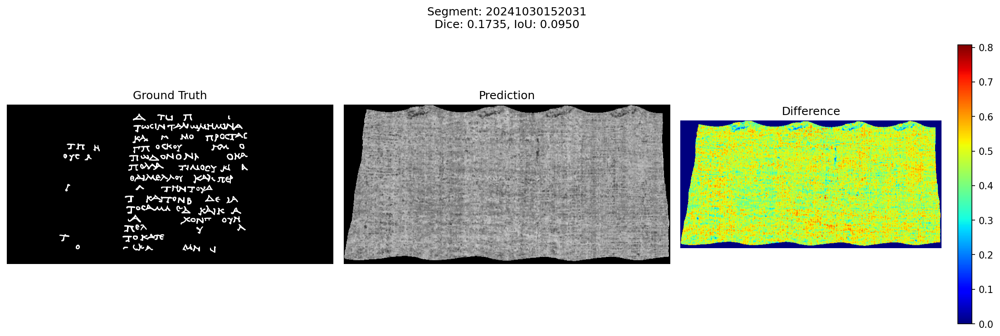

In [7]:
metrics, pred_mask, true_mask = evaluate_segment(
    segment_id="20241030152031", # vaild scroll5
    model_path="/home/jovyan/Bulygin/villa-main/ink-detection/outputs/vesuvius/timesformer_tilesize16_20231210121321_frepoch=4-v2.ckpt",
    data_path="./train_scrolls/"
)

100%|██████████| 2578/2578 [18:37<00:00,  2.31it/s]



Segmentation Metrics:
Segment ID: 20231210121321
Model: timesformer_tilesize16_20231210121321_frepoch=4-v2.ckpt
----------------------------------------
Dice Score: 0.5032
IoU Score: 0.3362
Precision: 0.4925
Recall: 0.5145


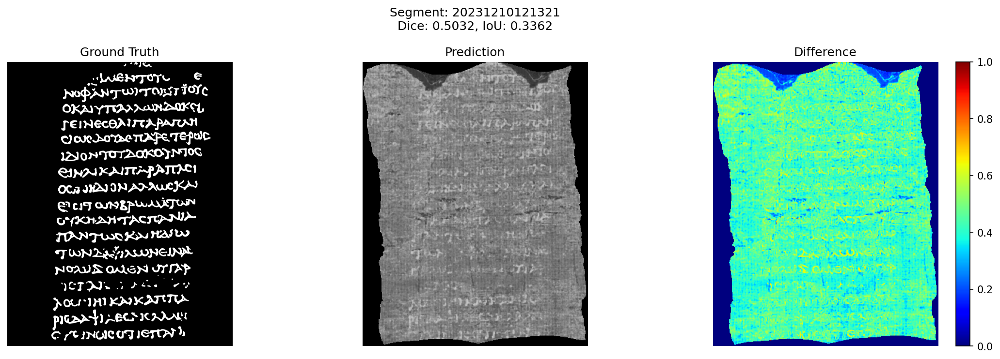

In [9]:
metrics, pred_mask, true_mask = evaluate_segment(
    segment_id="20231210121321", # vaild scroll5
    model_path="/home/jovyan/Bulygin/villa-main/ink-detection/outputs/vesuvius/timesformer_tilesize16_20231210121321_frepoch=4-v2.ckpt",
    data_path="./train_scrolls/"
)

# 100% DATA 

100%|██████████| 3183/3183 [06:52<00:00,  7.71it/s]



Segmentation Metrics:
Segment ID: 20241030152031
Model: timesformer_wild16_20231210121321_frepoch=14.ckpt
----------------------------------------
Dice Score: 0.2456
IoU Score: 0.1400
Precision: 0.3023
Recall: 0.2068


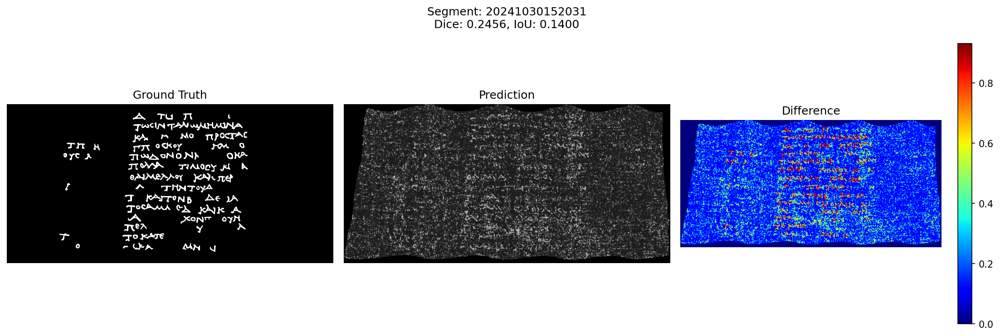

In [3]:
metrics, pred_mask, true_mask = evaluate_segment(
    segment_id="20241030152031", # vaild scroll5
    model_path="/home/jovyan/Bulygin/villa-main/ink-detection/outputs/vesuvius/alldata_batchsize196/vesuvius-models/timesformer_wild16_20231210121321_frepoch=14.ckpt",
    data_path="./train_scrolls/"
)

100%|██████████| 3183/3183 [06:51<00:00,  7.73it/s]



Segmentation Metrics:
Segment ID: 20241030152031
Model: timesformer_wild16_20231210121321_frepoch=5.ckpt
----------------------------------------
Dice Score: 0.2514
IoU Score: 0.1438
Precision: 0.2011
Recall: 0.3356


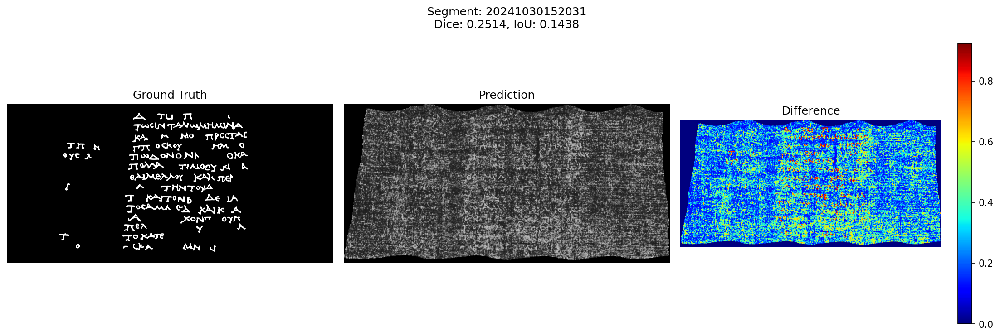

In [4]:
metrics, pred_mask, true_mask = evaluate_segment(
    segment_id="20241030152031", # vaild scroll5
    model_path="/home/jovyan/Bulygin/villa-main/ink-detection/outputs/vesuvius/alldata_batchsize196/vesuvius-models/timesformer_wild16_20231210121321_frepoch=5.ckpt",
    data_path="./train_scrolls/"
)

100%|██████████| 2578/2578 [06:09<00:00,  6.97it/s]



Segmentation Metrics:
Segment ID: 20231210121321
Model: timesformer_wild16_20231210121321_frepoch=14.ckpt
----------------------------------------
Dice Score: 0.4976
IoU Score: 0.3312
Precision: 0.8115
Recall: 0.3588


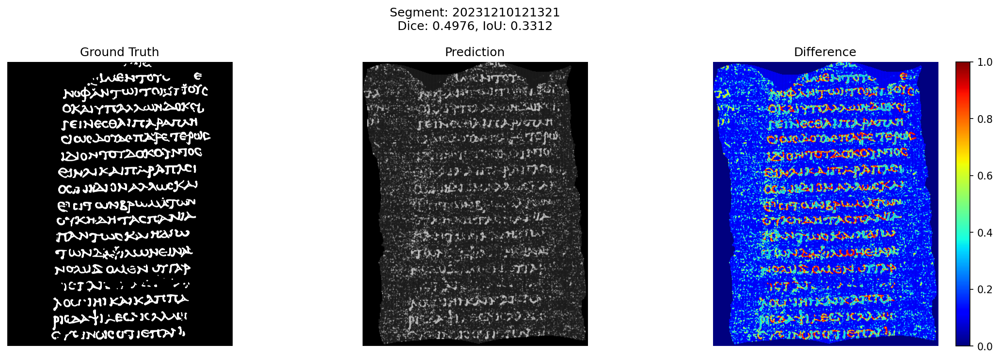

In [10]:
metrics, pred_mask, true_mask = evaluate_segment(
    segment_id="20231210121321", # vaild scroll1
    model_path="/home/jovyan/Bulygin/villa-main/ink-detection/outputs/vesuvius/alldata_batchsize196/vesuvius-models/timesformer_wild16_20231210121321_frepoch=14.ckpt",
    data_path="./train_scrolls/")

# 100% DATA 512 batchsize

100%|██████████| 3183/3183 [06:41<00:00,  7.92it/s]



Segmentation Metrics:
Segment ID: 20241030152031
Model: timesformer_wild16_20231210121321_frepoch=13.ckpt
----------------------------------------
Dice Score: 0.5930
IoU Score: 0.4215
Precision: 0.5280
Recall: 0.6764


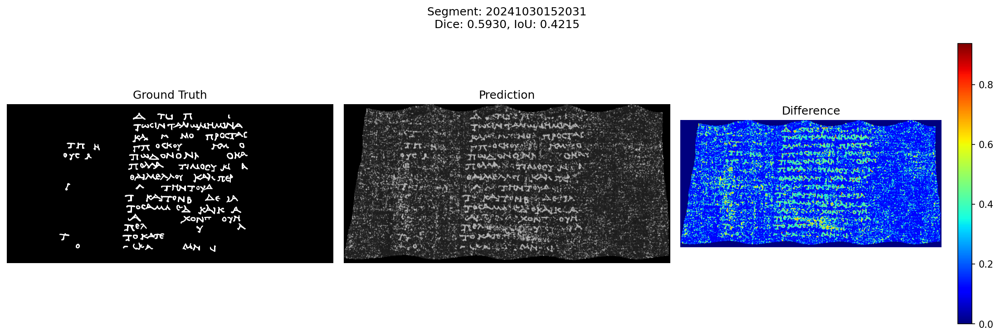

In [19]:
metrics, pred_mask, true_mask = evaluate_segment(
    segment_id="20241030152031", # vaild scroll5
    model_path="/home/jovyan/Bulygin/villa-main/ink-detection/outputs/vesuvius/pretraining_all/vesuvius-models/timesformer_wild16_20231210121321_frepoch=13.ckpt",
    data_path="./train_scrolls/"
)

100%|██████████| 2578/2578 [05:24<00:00,  7.94it/s]



Segmentation Metrics:
Segment ID: 20231210121321
Model: timesformer_wild16_20231210121321_frepoch=13.ckpt
----------------------------------------
Dice Score: 0.5454
IoU Score: 0.3749
Precision: 0.8229
Recall: 0.4078


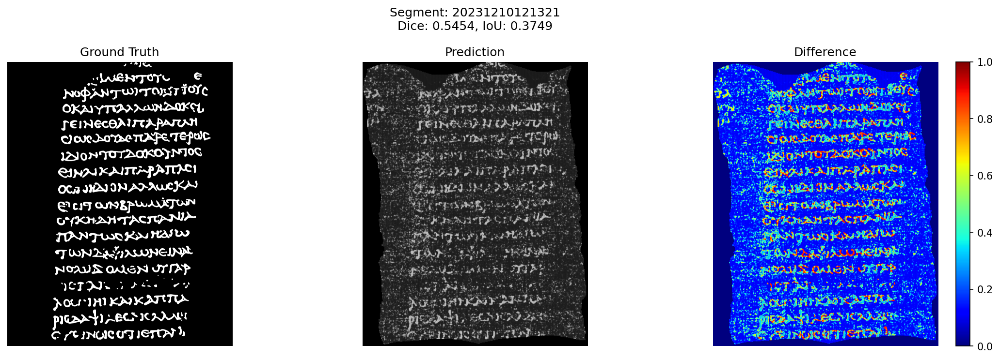

In [20]:
metrics, pred_mask, true_mask = evaluate_segment(
    segment_id="20231210121321", # vaild scroll1
    model_path="/home/jovyan/Bulygin/villa-main/ink-detection/outputs/vesuvius/pretraining_all/vesuvius-models/timesformer_wild16_20231210121321_frepoch=13.ckpt",
    data_path="./train_scrolls/"
)

# 70% data

100%|██████████| 3183/3183 [07:24<00:00,  7.16it/s]



Segmentation Metrics:
Segment ID: 20241030152031
Model: timesformer_wild16_20231210121321_frepoch=15.ckpt
----------------------------------------
Dice Score: 0.2726
IoU Score: 0.1578
Precision: 0.2321
Recall: 0.3302


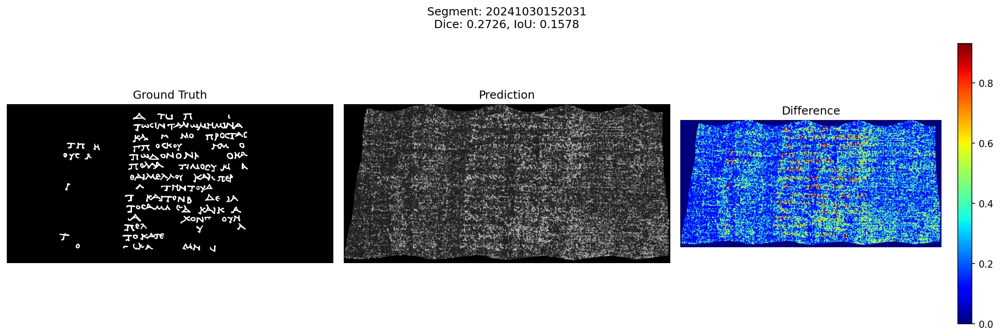

In [12]:
metrics, pred_mask, true_mask = evaluate_segment(
    segment_id="20241030152031", # vaild scroll5
    model_path="/home/jovyan/Bulygin/villa-main/ink-detection/outputs/vesuvius/pretraining_70proc/vesuvius-models/timesformer_wild16_20231210121321_frepoch=15.ckpt",
    data_path="./train_scrolls/"
)

100%|██████████| 2578/2578 [05:28<00:00,  7.86it/s]



Segmentation Metrics:
Segment ID: 20231210121321
Model: timesformer_wild16_20231210121321_frepoch=15.ckpt
----------------------------------------
Dice Score: 0.5302
IoU Score: 0.3607
Precision: 0.7942
Recall: 0.3979


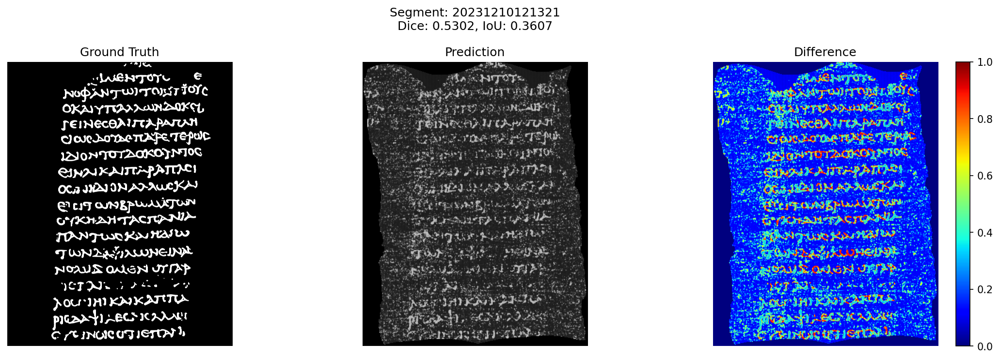

In [13]:
metrics, pred_mask, true_mask = evaluate_segment(
    segment_id="20231210121321", # vaild scroll1
    model_path="/home/jovyan/Bulygin/villa-main/ink-detection/outputs/vesuvius/pretraining_70proc/vesuvius-models/timesformer_wild16_20231210121321_frepoch=15.ckpt",
    data_path="./train_scrolls/")

# 50% DATA SPLIT 1

100%|██████████| 3183/3183 [06:35<00:00,  8.05it/s]



Segmentation Metrics:
Segment ID: 20241030152031
Model: timesformer_wild16_20231210121321_frepoch=16.ckpt
----------------------------------------
Dice Score: 0.3091
IoU Score: 0.1828
Precision: 0.3145
Recall: 0.3039


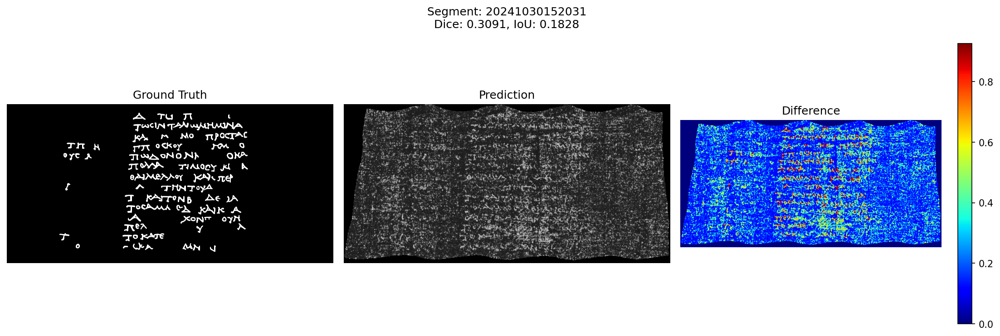

In [14]:
metrics, pred_mask, true_mask = evaluate_segment(
    segment_id="20241030152031", # vaild scroll5
    model_path="/home/jovyan/Bulygin/villa-main/ink-detection/outputs/vesuvius/pretraining_50proc/vesuvius-models/timesformer_wild16_20231210121321_frepoch=16.ckpt",
    data_path="./train_scrolls/"
)

100%|██████████| 2578/2578 [05:17<00:00,  8.13it/s]



Segmentation Metrics:
Segment ID: 20231210121321
Model: timesformer_wild16_20231210121321_frepoch=16.ckpt
----------------------------------------
Dice Score: 0.5288
IoU Score: 0.3594
Precision: 0.8031
Recall: 0.3942


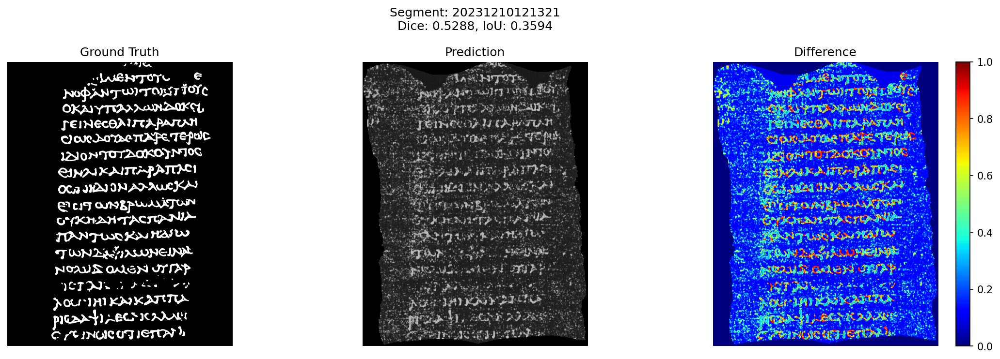

In [15]:
metrics, pred_mask, true_mask = evaluate_segment(
    segment_id="20231210121321", # vaild scroll1
    model_path="/home/jovyan/Bulygin/villa-main/ink-detection/outputs/vesuvius/pretraining_50proc/vesuvius-models/timesformer_wild16_20231210121321_frepoch=16.ckpt",
    data_path="./train_scrolls/")

# 50% DATA SPLIT 2

100%|██████████| 3183/3183 [06:38<00:00,  7.99it/s]



Segmentation Metrics:
Segment ID: 20241030152031
Model: timesformer_wild16_20231210121321_frepoch=15.ckpt
----------------------------------------
Dice Score: 0.5538
IoU Score: 0.3829
Precision: 0.5635
Recall: 0.5445


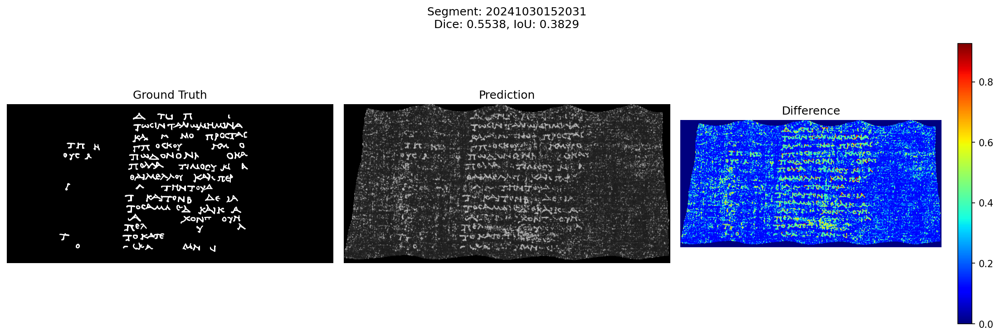

In [16]:
metrics, pred_mask, true_mask = evaluate_segment(
    segment_id="20241030152031", # vaild scroll5
    model_path="/home/jovyan/Bulygin/villa-main/ink-detection/outputs/vesuvius/pretraining_50proc-split2/vesuvius-models/timesformer_wild16_20231210121321_frepoch=15.ckpt",
    data_path="./train_scrolls/"
)

100%|██████████| 2578/2578 [05:22<00:00,  8.00it/s]



Segmentation Metrics:
Segment ID: 20231210121321
Model: timesformer_wild16_20231210121321_frepoch=15.ckpt
----------------------------------------
Dice Score: 0.5180
IoU Score: 0.3495
Precision: 0.7883
Recall: 0.3857


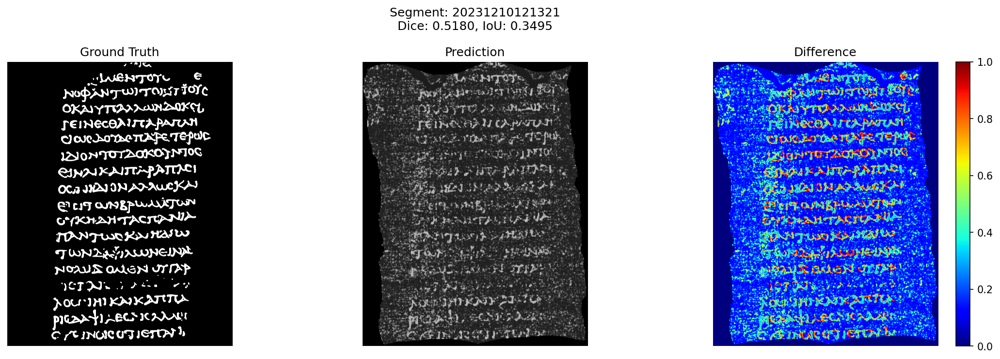

In [17]:
metrics, pred_mask, true_mask = evaluate_segment(
    segment_id="20231210121321", # vaild scroll1
    model_path="/home/jovyan/Bulygin/villa-main/ink-detection/outputs/vesuvius/pretraining_50proc-split2/vesuvius-models/timesformer_wild16_20231210121321_frepoch=15.ckpt",
    data_path="./train_scrolls/")

# PATCHSIZE 8 

In [23]:
import os
import torch
import numpy as np
import cv2
import wandb
from tqdm import tqdm
import segmentation_models_pytorch as smp
from torch.utils.data import DataLoader
import albumentations as A
from albumentations.pytorch import ToTensorV2
import PIL.Image
import matplotlib.pyplot as plt
from IPython.display import display
import scipy.stats as st
from torch.utils.data import Dataset
import torch.nn.functional as F
from timesformer_pytorch import TimeSformer
import torch.nn as nn
import torch.optim
import collections
from torch.serialization import add_safe_globals

# Добавляем необходимые классы в safe_globals
add_safe_globals([
    torch.optim.lr_scheduler.CosineAnnealingLR,
    torch.optim.AdamW,
    collections.defaultdict,
    dict
])

class CFG:
    # Базовая конфигурация
    in_chans = 26
    size = 64
    tile_size = 64
    stride = 32
    start_idx = 15
    workers = 4
    batch_size = 64
    device = 'cuda'
    model_compile = True
    
    valid_aug_list = [
        A.Resize(size, size),
        A.Normalize(
            mean=[0] * in_chans,
            std=[1] * in_chans
        ),
        ToTensorV2(transpose_mask=True),
    ]

def gkern(kernlen=21, nsig=3):
    """Returns a 2D Gaussian kernel."""
    x = np.linspace(-nsig, nsig, kernlen+1)
    kern1d = np.diff(st.norm.cdf(x))
    kern2d = np.outer(kern1d, kern1d)
    return kern2d/kern2d.sum()

class CustomDatasetTest(Dataset):
    def __init__(self, images, xyxys, cfg, transform=None):
        self.images = images
        self.xyxys = xyxys
        self.cfg = cfg
        self.transform = transform

    def __len__(self):
        return len(self.images)
    
    def __getitem__(self, idx):
        image = self.images[idx]
        xy = self.xyxys[idx]
        if self.transform:
            data = self.transform(image=image)
            image = data['image'].unsqueeze(0)
        return image, xy

class RegressionPLModel(nn.Module):
    def __init__(self, pred_shape=None, size=64, with_norm=False):
        super(RegressionPLModel, self).__init__()
        self.pred_shape = pred_shape
        self.with_norm = with_norm
        
        self.backbone=TimeSformer(
                dim = 512,
                image_size = 64,
                patch_size = 8,
                num_frames = 26,
                num_classes = 16,
                channels=1,
                depth = 8,
                heads = 8,
                dim_head =  64,
                attn_dropout = 0.1,
                ff_dropout = 0.1
            )
        
        if self.with_norm:
            self.normalization = nn.BatchNorm3d(num_features=1)

    def forward(self, x):
        if x.ndim == 4:
            x = x[:, None]
        if self.with_norm:
            x = self.normalization(x)
        x = self.backbone(torch.permute(x, (0, 2, 1, 3, 4)))
        x = x.view(-1, 1, 4, 4)
        return x

def evaluate_segment(
    segment_id: str,
    model_path: str,
    data_path: str = './train_scrolls',
    device: str = 'cuda',
    batch_size: int = 64,
    workers: int = 4,
    size: int = 64,
    stride: int = 32,
    start_idx: int = 15,
    model_compile: bool = True
):
    """
    Функция для оценки качества сегментации на одном сегменте.
    
    Параметры:
    segment_id (str): ID сегмента для оценки
    model_path (str): путь к файлу модели
    data_path (str): путь к директории с данными
    """
    device = torch.device(device if torch.cuda.is_available() else 'cpu')
    
    def read_image_mask(fragment_id, start_idx=15, end_idx=41):
        images = []
        idxs = range(start_idx, end_idx)

        for i in idxs:
            fragment_path = f"{data_path}/{fragment_id}/layers/{i:02}"
            if os.path.exists(f"{fragment_path}.tif"):
                image = cv2.imread(f"{fragment_path}.tif", 0)
            else:
                image = cv2.imread(f"{fragment_path}.jpg", 0)
            pad0 = (256 - image.shape[0] % 256)
            pad1 = (256 - image.shape[1] % 256)
            image = np.pad(image, [(0, pad0), (0, pad1)], constant_values=0)
            image = np.clip(image, 0, 200)
            images.append(image)
        images = np.stack(images, axis=2)
        
        # Загрузка маски сегмента
        fragment_mask = cv2.imread(f"{data_path}/{fragment_id}/{fragment_id}_mask.png", 0)
        fragment_mask = np.pad(fragment_mask, [(0, pad0), (0, pad1)], constant_values=0)
        
        # Загрузка ground truth маски
        true_mask = cv2.imread(f"{data_path}/{fragment_id}/{fragment_id}_inklabels.png", 0)
        true_mask = cv2.resize(true_mask, (images.shape[1], images.shape[0]))
        true_mask = true_mask.astype('float32') / 255.0
        
        return images, fragment_mask, true_mask

    def get_img_splits(fragment_id, s, e):
        images = []
        xyxys = []
        
        image, fragment_mask, true_mask = read_image_mask(fragment_id, s, e)
        
        x1_list = list(range(0, image.shape[1]-CFG.tile_size+1, stride))
        y1_list = list(range(0, image.shape[0]-CFG.tile_size+1, stride))
        
        for y1 in y1_list:
            for x1 in x1_list:
                y2 = y1 + CFG.tile_size
                x2 = x1 + CFG.tile_size
                if not np.any(fragment_mask[y1:y2, x1:x2]==0):
                    images.append(image[y1:y2, x1:x2])
                    xyxys.append([x1, y1, x2, y2])
                    
        test_dataset = CustomDatasetTest(
            images,
            np.stack(xyxys), 
            CFG,
            transform=A.Compose(CFG.valid_aug_list)
        )

        test_loader = DataLoader(
            test_dataset,
            batch_size=batch_size,
            shuffle=False,
            num_workers=workers,
            pin_memory=True,
            drop_last=False,
        )
        
        return test_loader, np.stack(xyxys), (image.shape[0], image.shape[1]), fragment_mask, true_mask

    def predict_fn(test_loader, model, device, test_xyxys, pred_shape):
        mask_pred = np.zeros(pred_shape)
        mask_count = np.zeros(pred_shape)
        kernel = gkern(CFG.size, 1)
        kernel = kernel / kernel.max()
        model.eval()

        kernel_tensor = torch.tensor(kernel, device=device)

        for step, (images, xys) in tqdm(enumerate(test_loader), total=len(test_loader)):
            images = images.to(device)
            with torch.no_grad():
                y_preds = model(images)
            y_preds = torch.sigmoid(y_preds)
            y_preds_resized = F.interpolate(y_preds.float(), scale_factor=16, mode='bilinear')
            y_preds_multiplied = y_preds_resized * kernel_tensor
            y_preds_multiplied = y_preds_multiplied.squeeze(1)
            y_preds_multiplied_cpu = y_preds_multiplied.cpu().numpy()

            for i, (x1, y1, x2, y2) in enumerate(xys):
                mask_pred[y1:y2, x1:x2] += y_preds_multiplied_cpu[i]
                mask_count[y1:y2, x1:x2] += np.ones((size, size))

        mask_pred /= np.clip(mask_count, a_min=1, a_max=None)
        return mask_pred

    def calculate_metrics(pred_mask, true_mask, threshold=0.5):
        """Calculate segmentation metrics."""
        # Преобразуем маски в тензоры PyTorch
        pred = torch.from_numpy(pred_mask[None, None, ...])
        target = torch.from_numpy(true_mask[None, None, ...])
        
        # Бинаризуем предсказания
        pred = (pred > threshold).float()
        target = (target > 0.5).float()
        
        # Вычисляем TP, FP, TN, FN
        tp = torch.sum((pred == 1) & (target == 1)).float()
        fp = torch.sum((pred == 1) & (target == 0)).float()
        tn = torch.sum((pred == 0) & (target == 0)).float()
        fn = torch.sum((pred == 0) & (target == 1)).float()
        
        # Вычисляем метрики
        precision = tp / (tp + fp + 1e-7)
        recall = tp / (tp + fn + 1e-7)
        dice = 2 * tp / (2 * tp + fp + fn + 1e-7)
        iou = tp / (tp + fp + fn + 1e-7)
        
        return {
            'dice': dice.item(),
            'iou': iou.item(),
            'precision': precision.item(),
            'recall': recall.item()
        }

    # Загрузка модели
    model = RegressionPLModel()
    checkpoint = torch.load(model_path, map_location=device, weights_only=False)  # Добавляем weights_only=False
    model.load_state_dict(checkpoint['state_dict'], strict=False)
    if model_compile:
        model = torch.compile(model)
    model.to(device)
    model.eval()

    # Получение данных для инференса
    img_split = get_img_splits(
        segment_id,
        start_idx,
        start_idx + 26  # количество входных каналов
    )
    
    if img_split is None:
        print(f"Failed to process segment {segment_id}")
        return None
        
    test_loader, test_xyxys, test_shape, fragment_mask, true_mask = img_split

    # Инференс
    pred_mask = predict_fn(test_loader, model, device, test_xyxys, test_shape)
    pred_mask = np.clip(np.nan_to_num(pred_mask), a_min=0, a_max=1)
    
    # Расчет метрик
    pred_mask_bin = (pred_mask > 0.5).astype(np.uint8)
    true_mask_bin = (true_mask > 0.5).astype(np.uint8)
    
    metrics = calculate_metrics(pred_mask, true_mask)
    
    # Вывод результатов
    print("\nSegmentation Metrics:")
    print(f"Segment ID: {segment_id}")
    print(f"Model: {os.path.basename(model_path)}")
    print("-" * 40)
    print(f"Dice Score: {metrics['dice']:.4f}")
    print(f"IoU Score: {metrics['iou']:.4f}")
    print(f"Precision: {metrics['precision']:.4f}")
    print(f"Recall: {metrics['recall']:.4f}")
    
    # Визуализация
    fig = plt.figure(figsize=(15, 5), dpi=150)
    
    plt.subplot(131)
    plt.imshow(true_mask, cmap='gray')
    plt.title('Ground Truth')
    plt.axis('off')
    
    plt.subplot(132)
    plt.imshow(pred_mask, cmap='gray')
    plt.title('Prediction')
    plt.axis('off')
    
    plt.subplot(133)
    plt.imshow(np.abs(true_mask - pred_mask), cmap='jet')
    plt.title('Difference')
    plt.colorbar()
    plt.axis('off')
    
    plt.suptitle(f"Segment: {segment_id}\nDice: {metrics['dice']:.4f}, IoU: {metrics['iou']:.4f}")
    plt.tight_layout()
    plt.show()
    #plt.close()
    
    return metrics, pred_mask, true_mask

100%|██████████| 3183/3183 [25:18<00:00,  2.10it/s]



Segmentation Metrics:
Segment ID: 20241030152031
Model: timesformer_wild16_20231210121321_frepoch=4.ckpt
----------------------------------------
Dice Score: 0.3430
IoU Score: 0.2070
Precision: 0.2874
Recall: 0.4254


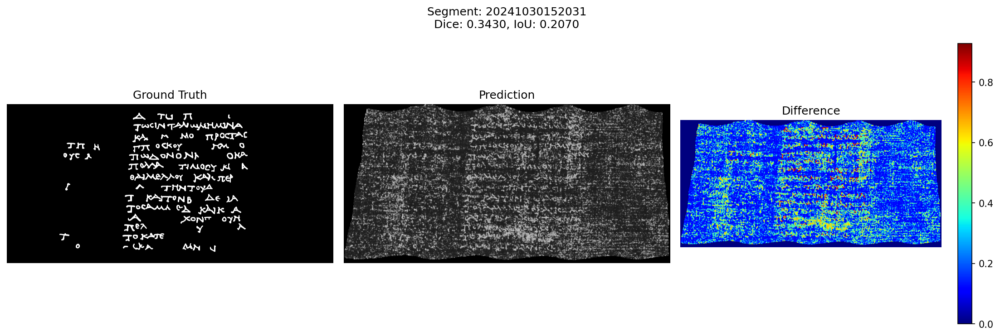

In [8]:
metrics, pred_mask, true_mask = evaluate_segment(
    segment_id="20241030152031", # vaild scroll5
    model_path="/home/jovyan/Bulygin/villa-main/ink-detection/outputs/vesuvius/alldata_batchsize96_patchsize8/vesuvius-models/timesformer_wild16_20231210121321_frepoch=4.ckpt",
    data_path="./train_scrolls/")

100%|██████████| 2578/2578 [18:52<00:00,  2.28it/s]



Segmentation Metrics:
Segment ID: 20231210121321
Model: timesformer_wild16_20231210121321_frepoch=4.ckpt
----------------------------------------
Dice Score: 0.5984
IoU Score: 0.4269
Precision: 0.8354
Recall: 0.4661


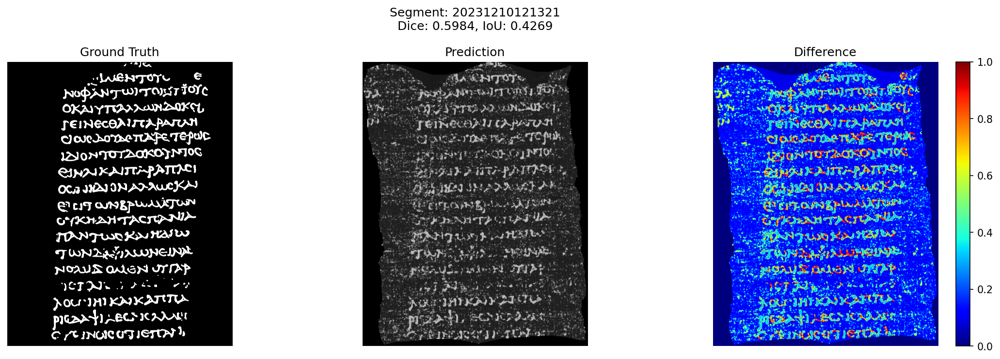

In [13]:
metrics, pred_mask, true_mask = evaluate_segment(
    segment_id="20231210121321", # vaild scroll1
    model_path="/home/jovyan/Bulygin/villa-main/ink-detection/outputs/vesuvius/alldata_batchsize96_patchsize8/vesuvius-models/timesformer_wild16_20231210121321_frepoch=4.ckpt",
    data_path="./train_scrolls/")

# Patchsize 8 old data and 8 heads

  0%|          | 0/3183 [00:00<?, ?it/s]/home/jovyan/Bulygin/venv_scrolls/lib/python3.13/site-packages/torch/_inductor/compile_fx.py:194: UserWarning: TensorFloat32 tensor cores for float32 matrix multiplication available but not enabled. Consider setting `torch.set_float32_matmul_precision('high')` for better performance.
  warnings.warn(
100%|██████████| 3183/3183 [26:32<00:00,  2.00it/s]



Segmentation Metrics:
Segment ID: 20241030152031
Model: old_patchsize8_frepoch=13.ckpt
----------------------------------------
Dice Score: 0.7208
IoU Score: 0.5635
Precision: 0.6498
Recall: 0.8092


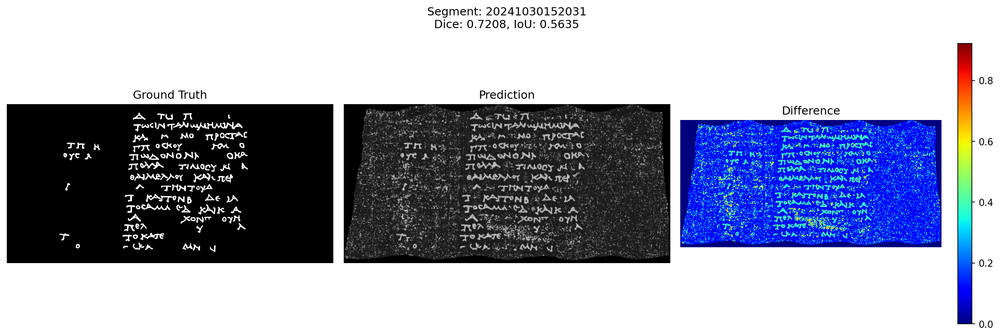

In [24]:
metrics, pred_mask, true_mask = evaluate_segment(
    segment_id="20241030152031", # vaild scroll5
    model_path="/home/jovyan/Bulygin/villa-main/ink-detection/outputs/vesuvius/old_patchsize8_frepoch=13.ckpt",
    data_path="./train_scrolls/")

100%|██████████| 2578/2578 [20:27<00:00,  2.10it/s]



Segmentation Metrics:
Segment ID: 20231210121321
Model: old_patchsize8_frepoch=13.ckpt
----------------------------------------
Dice Score: 0.6904
IoU Score: 0.5272
Precision: 0.8827
Recall: 0.5669


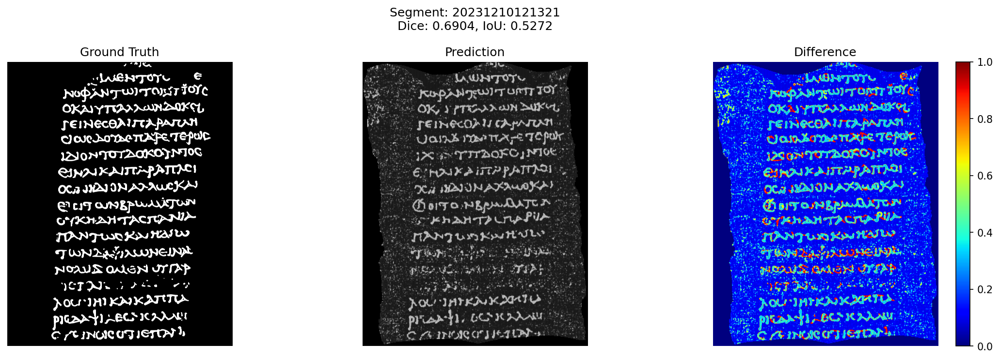

In [25]:
metrics, pred_mask, true_mask = evaluate_segment(
    segment_id="20231210121321", # vaild scroll1
    model_path="/home/jovyan/Bulygin/villa-main/ink-detection/outputs/vesuvius/old_patchsize8_frepoch=13.ckpt",
    data_path="./train_scrolls/")